# imports

In [1]:
import numpy as np
import anndata as ad
import pandas as pd
import scanpy as sc
import palettable
import scanpy.external as sce
import pyfpgrowth

# setting

In [2]:
sc.set_figure_params(dpi=500, color_map='viridis',dpi_save=500,transparent=True)
heatmap_cmp = palettable.cmocean.diverging.Balance_20.mpl_colormap


# functions

# data loading

## slide-seq

In [119]:
slideseq_root = '/home/yzy/PUBDT/st/slideseq/'
slideseq_name = 'Puck_180413_7'

# read count
# g个基因，n个细胞，每一行是一个基因，前两列是ENSEMBL／gene；其后是按顺序的细胞
gene_list = []
ENSEMBL_list = []
cell_list = []
count_list = []
slideseq_count_file = slideseq_root+slideseq_name+'.count'
with open(slideseq_count_file,'r') as f:
    i=0
    for line in f:
        line = str.strip(line)
        line_sp = line.split(',')
        if i==0:
            cell_list = line_sp[2:]
        else:
            ENSEMBL_list.append(line_sp[0])
            gene_list.append(line_sp[1])
            count_list.append(line_sp[2:])
        i+=1
# g*n
count_mat = np.array(count_list).astype('int')


cellid_list=[]
index_list=[]
x_list=[]
y_list=[]
slideseq_index_file = slideseq_root+slideseq_name+'.idx'
with open(slideseq_index_file) as f:
    i=0
    for line in f:
        line = str.strip(line)
        line_sp = line.split(',')
        if i==0:
            i+=1
            continue
        else:
            cellid_list.append(line_sp[0])
            index_list.append(line_sp[1])
            x_list.append(line_sp[2])
            y_list.append(line_sp[3])
        i+=1
x_list = np.array(x_list).astype('float32')
y_list = np.array(y_list).astype('float32')
            

In [120]:
in_X = np.transpose(count_mat)
obs_name = index_list
# g = map(str,range(in_X.shape[1]))
g = gene_list

obs = pd.DataFrame(index=obs_name)

# var_name must be str
var = pd.DataFrame(index=g)
# obs['barcode'] = np.array(index_list)
var['ENSEMBL'] = np.array(ENSEMBL_list)
# obs['true_labels'] = np.array(tenx_73k_label)
# obs['true_labels'] = obs['true_labels'].astype('category')
#     var['Genes'] = Genes
adata = ad.AnnData(in_X,  obs=obs,var=var, dtype='float32')
adata.obsm['spatial'] = np.concatenate((x_list.reshape(-1,1),y_list.reshape(-1,1)),axis=1)
adata.obs['spatial_x'] = x_list
adata.obs['spatial_y'] = y_list
adata.raw=adata

# data processing

In [9]:
adata_sam = sce.tl.sam(adata,inplace=False)
adata_sam=adata_sam[0].adata

RUNNING SAM
Iteration: 0, Convergence: 0.0916776338129444


/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/envs/scaden/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


Iteration: 1, Convergence: 0.06903918266334548


/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/envs/scaden/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


Iteration: 2, Convergence: 0.00621214811459168


/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/envs/scaden/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


Computing the UMAP embedding...


/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/envs/scaden/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))
/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/envs/scaden/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.nji

Elapsed time: 72.08362078666687 seconds


In [19]:
sc.tl.louvain(adata_sam,resolution=0.5)

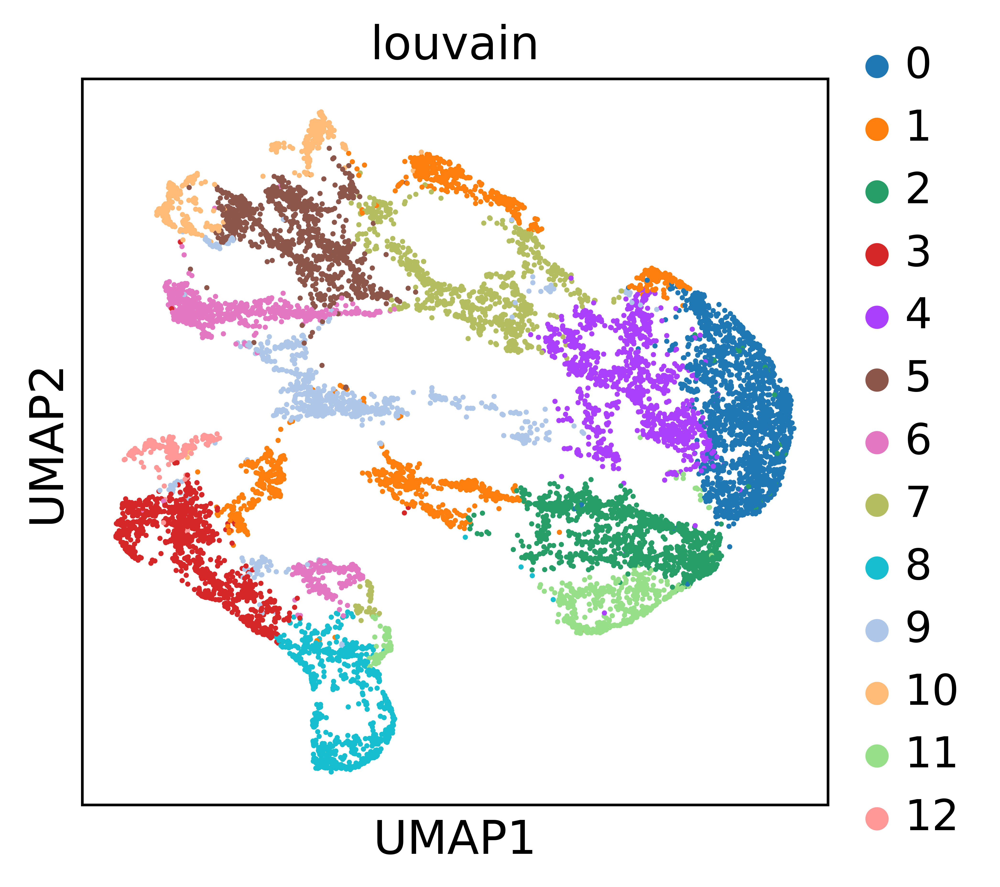

In [203]:
sc.pl.umap(adata_sam,color=['louvain'])

In [21]:
adata_sam.X

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.]], dtype=float32)

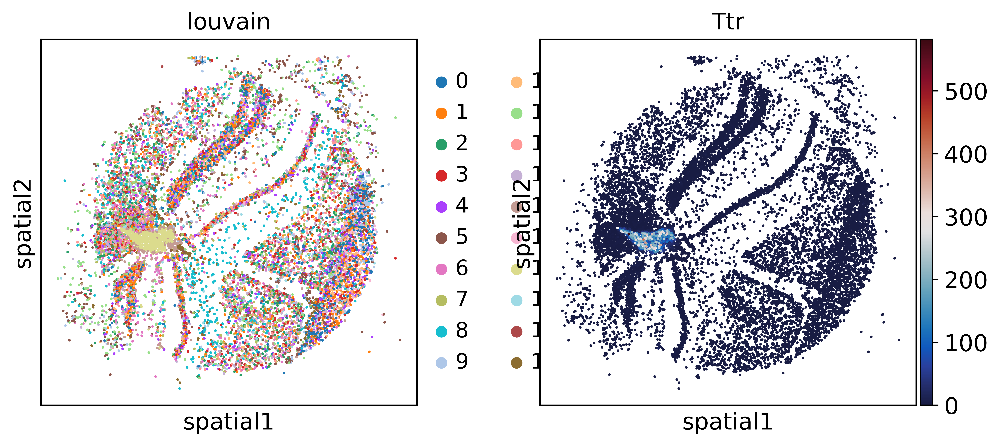

In [16]:
sc.pl.embedding(adata_sam,basis='spatial',color=['louvain','Ttr'],color_map=heatmap_cmp)

In [121]:
sc.pp.normalize_per_cell(adata)
sc.pp.log1p(adata)


In [122]:
sc.pp.highly_variable_genes(adata, n_top_genes=200)

In [123]:
adata = adata[:, adata.var.highly_variable]

In [124]:
sc.pp.scale(adata)
sc.tl.pca(adata)

/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:912: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [125]:
sc.pp.neighbors(adata)

/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../anaconda3/envs/scaden/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


In [126]:
sc.tl.umap(adata)

In [127]:
sc.tl.louvain(adata)

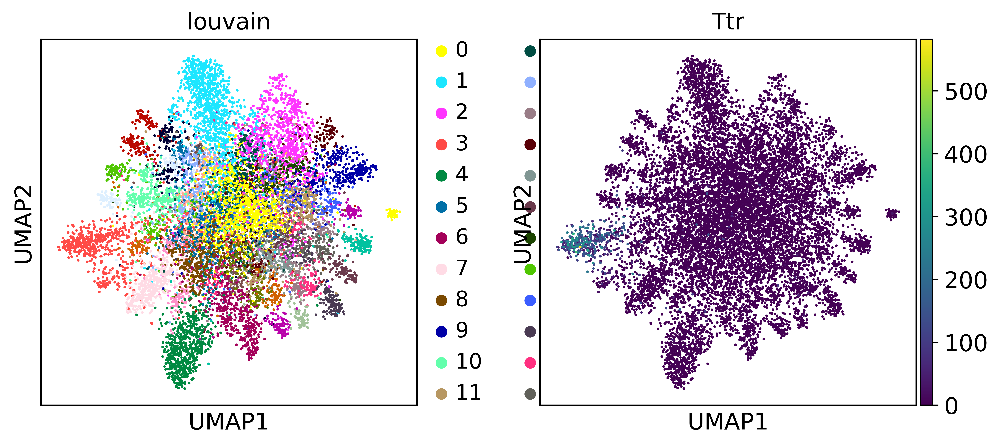

In [128]:
sc.pl.umap(adata,color=['louvain','Ttr'])

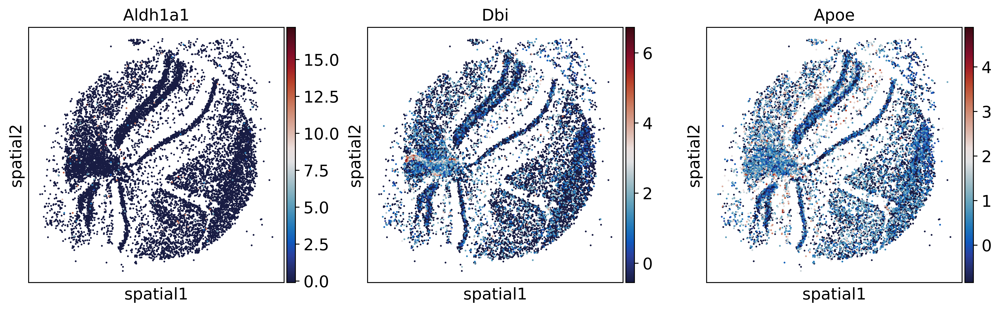

In [181]:
sc.pl.embedding(adata,basis='spatial',color=['Aldh1a1','Dbi','Apoe'],color_map=heatmap_cmp,use_raw=False)

In [39]:
np.sum(adata.obs['louvain']=='8')

637

In [47]:
np.sum(np.sum(adata.raw[:,'Ttr'].X!=0))

6821

In [130]:
adata.X.shape

(12282, 200)

# FP test

In [77]:
adata['GAACTAAAAACCC','0610009B22Rik'].X[0][0]

-0.15760456

In [73]:
adata.obs_names

Index(['GAACTAAAAACCC', 'AGCTGTAAAGGGG', 'TCTTCTAGAAGGT', 'TGCCAGCAAAGGA',
       'GTTCCATAAGAAG', 'AGCAGGTAAAGGA', 'TTGCATTAAGAAT', 'CCCTCAAAGGGTG',
       'GACTTAAAAGCAG', 'GTTGCATAAGTGG',
       ...
       'AACGGTTTATTAT', 'TGCACTTTATTAT', 'TGTGTTTGCTATA', 'GGTGTCTGATATA',
       'ATGTCCTGCGCGC', 'TATGCATGCGCGC', 'GGCGCCTGATATA', 'TGACGCTCGCGCG',
       'CTGAGTTATCGCG', 'AATCGTTAGATAT'],
      dtype='object', length=12282)

In [72]:
adata.var_names

Index(['0610009B22Rik', '1110004F10Rik', '1110008P14Rik', '1110032A03Rik',
       '1110051M20Rik', '1110059G10Rik', '1110065P20Rik', '1500009C09Rik',
       '1500011B03Rik', '1500015O10Rik',
       ...
       'mt-Tc', 'mt-Tf', 'mt-Ti', 'mt-Tl1', 'mt-Tl2', 'mt-Tm', 'mt-Tp',
       'mt-Tq', 'mt-Ts2', 'mt-Tv'],
      dtype='object', length=3235)

In [71]:
np.mean(adata.X,axis=0)

array([ 7.1700768e-08, -2.3455559e-07,  2.8118329e-08, ...,
        1.1234853e-06, -1.8878687e-07,  3.1061194e-07], dtype=float32)

In [138]:
t = np.array(adata[0,:].X)[0,:]
tt = (t>=0).astype('str')

In [149]:
ttt=np.where(cur_cell_bin=='False')[0]

In [151]:
g_names[ttt].shape

(174,)

In [160]:
trans_list = []
i=0
g_n = adata.shape[1]
g_names = adata.var_names
for c in adata.obs_names:
    i+=1
    if i%100==0:
        
        print(i/100)
    cur_cell = np.array(adata[c,:].X)[0,:]
    cur_cell_bin = (cur_cell>=0)
    true_idx = np.where(cur_cell_bin)[0]
#     cur_trans = [g_names[g] for g in true_idx]
    cur_trans = list(g_names[true_idx])
    
    
    trans_list.append(cur_trans)

1.0
2.0
3.0
4.0
5.0
6.0
7.0
8.0
9.0
10.0
11.0
12.0
13.0
14.0
15.0
16.0
17.0
18.0
19.0
20.0
21.0
22.0
23.0
24.0
25.0
26.0
27.0
28.0
29.0
30.0
31.0
32.0
33.0
34.0
35.0
36.0
37.0
38.0
39.0
40.0
41.0
42.0
43.0
44.0
45.0
46.0
47.0
48.0
49.0
50.0
51.0
52.0
53.0
54.0
55.0
56.0
57.0
58.0
59.0
60.0
61.0
62.0
63.0
64.0
65.0
66.0
67.0
68.0
69.0
70.0
71.0
72.0
73.0
74.0
75.0
76.0
77.0
78.0
79.0
80.0
81.0
82.0
83.0
84.0
85.0
86.0
87.0
88.0
89.0
90.0
91.0
92.0
93.0
94.0
95.0
96.0
97.0
98.0
99.0
100.0
101.0
102.0
103.0
104.0
105.0
106.0
107.0
108.0
109.0
110.0
111.0
112.0
113.0
114.0
115.0
116.0
117.0
118.0
119.0
120.0
121.0
122.0


In [176]:
patterns = pyfpgrowth.find_frequent_patterns(trans_list, 50)

In [177]:
rules = pyfpgrowth.generate_association_rules(patterns, 0.7)

In [184]:
pd_dict = {
    'n_items':[],
    'items':[],
    'support':[]
}
for p in patterns.keys():
    cur_n_items = len(p)
    cur_support = patterns[p]
    pd_dict['n_items'].append(cur_n_items)
    pd_dict['items'].append(p)
    pd_dict['support'].append(cur_support)
pd_df = pd.DataFrame(pd_dict)

In [188]:
pd_df[pd_df.n_items==7]

,n_items,items,support
11357,7,"(Cnp, Cryab, Mbp, Mobp, Plp1, Ptgds, Trf)",50
11473,7,"(Car2, Cnp, Cryab, Mbp, Plp1, Qdpr, Trf)",52
11483,7,"(Car2, Cnp, Cryab, Plp1, Ptgds, Qdpr, Trf)",52
11516,7,"(Apoe, Car2, Cnp, Cryab, Mbp, Plp1, Trf)",50
11537,7,"(Car2, Cnp, Cryab, Mbp, Plp1, Ptgds, Trf)",57
11719,7,"(Car2, Cryab, Mbp, Plp1, Ptgds, Qdpr, Trf)",54
13310,7,"(Car2, Cnp, Cryab, Mbp, Plp1, Ptgds, Qdpr)",54
13432,7,"(Car2, Cnp, Cryab, Glul, Mbp, Plp1, Ptgds)",52
14347,7,"(Car2, Cryab, Mbp, Mobp, Plp1, Ptgds, Qdpr)",51
15991,7,"(Car2, Cryab, Mbp, Plp1, Ptgds, Qdpr, Sept4)",50


In [193]:
trans = [
    ['a','a','a','b','b','c'],
    ['a','a','b','b','b','c','c'],
    
]

In [198]:
patterns = pyfpgrowth.find_frequent_patterns(trans, 2)

In [199]:
patterns

{('a', 'a', 'c'): 5,
 ('a', 'a', 'b', 'c'): 12,
 ('a', 'b', 'c'): 18,
 ('a', 'b', 'b', 'c'): 15,
 ('b', 'c'): 8,
 ('b', 'b', 'c'): 7,
 ('a',): 5,
 ('a', 'a'): 4,
 ('b', 'b'): 4,
 ('a', 'b', 'b'): 9,
 ('a', 'b'): 12,
 ('a', 'a', 'b'): 9}

In [200]:
patterns = pyfpgrowth.find_frequent_patterns(trans, 1)

In [201]:
patterns

{('c', 'c'): 1,
 ('a', 'c', 'c'): 2,
 ('b', 'c', 'c'): 3,
 ('a', 'b', 'c', 'c'): 2,
 ('a', 'a', 'a', 'c'): 1,
 ('a', 'a', 'a', 'b', 'c'): 2,
 ('a', 'a', 'b', 'c'): 12,
 ('a', 'a', 'b', 'b', 'c'): 9,
 ('a', 'b', 'c'): 18,
 ('a', 'b', 'b', 'c'): 15,
 ('b', 'c'): 8,
 ('b', 'b', 'c'): 7,
 ('a',): 5,
 ('a', 'a'): 4,
 ('b', 'b', 'b'): 1,
 ('a', 'b', 'b', 'b'): 2,
 ('a', 'b', 'b'): 9,
 ('a', 'a', 'b', 'b'): 6,
 ('a', 'b'): 12,
 ('a', 'a', 'b'): 9}